In [1]:
import cv2
from glob import glob
from tqdm.autonotebook import tqdm
import os
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import cv2
import numpy as np

C:\Users\LEELA\AppData\Local\Temp\ipykernel_23624\3688577432.py:3: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from tqdm.autonotebook import tqdm


In [2]:

print(f"Current working directory: {os.getcwd()}")

Current working directory: c:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project


In [3]:
! mkdir kaggle
! cd kaggle

A subdirectory or file kaggle already exists.


In [7]:
# Define the video and output directories
video_directories = {
    "SVCD_converted": r"c:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\SCVD\SVCD_converted",
    "Train_Normal": r"C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\SCVD\SCVD_converted_sec_split\Train\Normal",
    "Train_Violence": r"C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\SCVD\SCVD_converted_sec_split\Train\Violence",
    "Train_Weaponised": r"C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\SCVD\SCVD_converted_sec_split\Train\weaponized",
    "Test_Normal": r"C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\SCVD\SCVD_converted_sec_split\Test\Normal",
    "Test_Violence": r"C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\SCVD\SCVD_converted_sec_split\Test\violence",
    "Test_Weaponised": r"C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\SCVD\SCVD_converted_sec_split\Test\Weaponized"
}

output_directories = {
    "SVCD_converted": r"c:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\images\SVCD_converted",
    "Train_Normal": r"c:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\images\Train\normal",
    "Train_Violence": r"c:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\images\Train\violence",
    "Train_Weaponised": r"c:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\images\Train\weaponised",
    "Test_Normal": r"c:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\images\Test\normal",
    "Test_Violence": r"c:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\images\Test\violence",
    "Test_Weaponised": r"c:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\images\Test\weaponised"
}


In [5]:
import cv2
from glob import glob
import os

# Function to convert videos to frames
def video_to_frames(video_dir, output_dir, frame_rate=1):
    # Ensure the output directory exists
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)

    # Get list of all video files in the directory (looking for .avi files)
    video_files = glob(os.path.join(video_dir, '*.avi'))

    # Check if there are any video files to process
    if len(video_files) == 0:
        print(f"No video files found in {video_dir}")
        return

    # Loop through each video file
    for video_file in video_files:
        video_name = os.path.splitext(os.path.basename(video_file))[0]
        output_path = os.path.join(output_dir, video_name)
        if not os.path.exists(output_path):
            os.makedirs(output_path)

        cap = cv2.VideoCapture(video_file)
        count = 0
        success = True

        while success:
            success, frame = cap.read()
            if count % frame_rate == 0 and success:
                frame_filename = os.path.join(output_path, f"{video_name}_frame{count:04d}.jpg")
                cv2.imwrite(frame_filename, frame)
            count += 1

        cap.release()
        print(f"Extracted frames from {video_file} to {output_path}")


# Convert videos to frames for each directory
for key in video_directories:
    print(f"Processing videos in: {video_directories[key]}")
    video_to_frames(video_directories[key], output_directories[key])
    print(f"Finished processing: {key}\n")

print("All videos have been processed and frames extracted.")


Processing videos in: c:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\SCVD\SVCD_converted
No video files found in c:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\SCVD\SVCD_converted
Finished processing: SVCD_converted

Processing videos in: C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\SCVD\SCVD_converted_sec_split\Train\Normal
Extracted frames from C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\SCVD\SCVD_converted_sec_split\Train\Normal\Normal001.avi to c:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\images\Train\normal\Normal001
Extracted frames from C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\SCVD\SCVD_converted_sec_split\Train\Normal\Normal002.avi to c:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\images\Train\normal\Normal002
Extracted frames from C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\SCVD\SCVD_converted_sec_split\Train\Normal\Normal003.avi to c:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\images\Train\normal\Normal003
Extracted frames from C

In [25]:
base_dir = r"c:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle"
preprocessed_directories = {
    "SVCD_converted": os.path.join(base_dir, "preprocessed/SVCD_converted"),
    "Train_Normal": os.path.join(base_dir, "preprocessed/Train/normal"),
    "Train_Violence": os.path.join(base_dir, "preprocessed/Train/violence"),
    "Train_Weaponised": os.path.join(base_dir, "preprocessed/Train/weaponised"),
    "Test_Normal": os.path.join(base_dir, "preprocessed/Test/normal"),
    "Test_Violence": os.path.join(base_dir, "preprocessed/Test/violence"),
    "Test_Weaponised": os.path.join(base_dir, "preprocessed/Test/weaponised")
}

def create_directories(directory_dict):
    for key, path in directory_dict.items():
        if not os.path.exists(path):
            os.makedirs(path)
            print(f"Created directory: {path}")
        else:
            print(f"Directory already exists: {path}")
# Create directories for preprocessed data
create_directories(preprocessed_directories)


Directory already exists: c:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\preprocessed/SVCD_converted
Directory already exists: c:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\preprocessed/Train/normal
Directory already exists: c:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\preprocessed/Train/violence
Directory already exists: c:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\preprocessed/Train/weaponised
Directory already exists: c:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\preprocessed/Test/normal
Directory already exists: c:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\preprocessed/Test/violence
Directory already exists: c:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\preprocessed/Test/weaponised


In [15]:
# Function to preprocess images
def preprocess_images(input_dir, output_dir, target_size=(224, 224)):
    # List all subdirectories in the input directory
    subdirs = glob(os.path.join(input_dir, '*'))

    for subdir in subdirs:
        # List all image files in the subdirectory
        image_files = glob(os.path.join(subdir, '*.jpg'))
        for image_file in image_files:
            # Read the image
            img = cv2.imread(image_file)

            # Resize the image to the target size
            img_resized = cv2.resize(img, target_size)

            # Normalize the image (convert pixel values to the range [0, 1])
            img_normalized = img_resized / 255.0

            # Save the preprocessed image to the output directory
            # Maintain the same directory structure
            subdir_name = os.path.basename(subdir)
            output_subdir = os.path.join(output_dir, subdir_name)
            if not os.path.exists(output_subdir):
                os.makedirs(output_subdir)

            output_file = os.path.join(output_subdir, os.path.basename(image_file))
            cv2.imwrite(output_file, (img_normalized * 255).astype(np.uint8))

            print(f"Preprocessed {image_file} -> {output_file}")

# Preprocess images for each directory
for key in output_directories:
    preprocess_images(output_directories[key], preprocessed_directories[key])

Preprocessed c:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\images\Train\normal\Normal001\Normal001_frame0000.jpg -> c:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\preprocessed/Train/normal\Normal001\Normal001_frame0000.jpg
Preprocessed c:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\images\Train\normal\Normal001\Normal001_frame0001.jpg -> c:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\preprocessed/Train/normal\Normal001\Normal001_frame0001.jpg
Preprocessed c:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\images\Train\normal\Normal001\Normal001_frame0002.jpg -> c:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\preprocessed/Train/normal\Normal001\Normal001_frame0002.jpg
Preprocessed c:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\images\Train\normal\Normal001\Normal001_frame0003.jpg -> c:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\preprocessed/Train/normal\Normal001\Normal001_frame0003.jpg
Preprocessed c:\Users\LEELA\Desktop\CYS\

In [28]:
# Function to count all frames in a given directory
def count_frames_in_directory(directory):
    total_frames = 0
    video_folders = os.listdir(directory)

    for folder in video_folders:
        folder_path = os.path.join(directory, folder)
        if os.path.isdir(folder_path):
            frames = glob(os.path.join(folder_path, '*.jpg'))
            total_frames += len(frames)

    return total_frames

# Directories for train dataset
train_directories = {
    "normal": r"C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\preprocessed\Train\normal",
    "violence": r"C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\preprocessed\Train\violence",
    "weaponized": r"C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\preprocessed\Train\weaponised"
}

# Count frames in each directory
for category, path in train_directories.items():
    frame_count = count_frames_in_directory(path)
    print(f"Total frames in '{category}' directory: {frame_count}")

# Sum all frames in the train dataset
total_frames_train = sum(count_frames_in_directory(path) for path in train_directories.values())
print(f"Total number of frames in the Train dataset: {total_frames_train}")


Total frames in 'normal' directory: 26160
Total frames in 'violence' directory: 29088
Total frames in 'weaponized' directory: 25817
Total number of frames in the Train dataset: 81065


In [30]:
def count_files_in_directory(directory):
    return len(glob(os.path.join(directory, '*')))

# Check frame counts in directories
for key, path in output_directories.items():
    count = count_files_in_directory(path)
    print(f"Number of frames in {path}: {count}")

# Check preprocessed directories
for key, path in preprocessed_directories.items():
    count = count_files_in_directory(path)
    print(f"Number of frames in {path}: {count}")


Number of frames in c:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\images\SVCD_converted: 0
Number of frames in c:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\images\Train\normal: 872
Number of frames in c:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\images\Train\violence: 970
Number of frames in c:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\images\Train\weaponised: 832
Number of frames in c:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\images\Test\normal: 169
Number of frames in c:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\images\Test\violence: 118
Number of frames in c:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\images\Test\weaponised: 190
Number of frames in c:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\preprocessed/SVCD_converted: 0
Number of frames in c:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\preprocessed/Train/normal: 872
Number of frames in c:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\prep

In [32]:
import cv2
import os
import numpy as np
from glob import glob

# Function to create video clips from frames and save as NumPy arrays
def frames_to_numpy_clip(input_dir, output_dir, frames_per_segment=10, frame_size=(224, 224)):
    # Ensure the output directory exists
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)
    
    # Loop through each folder in the input directory
    video_folders = os.listdir(input_dir)
    
    for folder in video_folders:
        folder_path = os.path.join(input_dir, folder)
        if os.path.isdir(folder_path):
            frame_files = sorted(glob(os.path.join(folder_path, '*.jpg')))
            
            if len(frame_files) == 0:
                print(f"No frames found in {folder_path}")
                continue
            
            segment_count = 0
            # Process frames in groups of `frames_per_segment`
            for i in range(0, len(frame_files), frames_per_segment):
                segment_frames = frame_files[i:i + frames_per_segment]
                
                # Create an empty list to hold the frames
                clip_frames = []
                
                for frame_file in segment_frames:
                    img = cv2.imread(frame_file)
                    resized_img = cv2.resize(img, frame_size)
                    clip_frames.append(resized_img)
                
                # Convert the list of frames into a NumPy array
                clip_array = np.array(clip_frames)
                
                # Save the NumPy array as .npy file
                numpy_filename = f"{folder}_segment_{segment_count:03d}.npy"
                numpy_path = os.path.join(output_dir, numpy_filename)
                np.save(numpy_path, clip_array)
                
                print(f"Created NumPy array segment {numpy_path} with {len(clip_frames)} frames")
                segment_count += 1

# Directory paths
preprocessed_directories = {
    "SVCD_converted": r"C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\preprocessed\SVCD_converted",
    "Train_Normal": r"C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\preprocessed\Train\normal",
    "Train_Violence": r"C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\preprocessed\Train\violence",
    "Train_Weaponised": r"C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\preprocessed\Train\weaponised",
    "Test_Normal": r"C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\preprocessed\Test\normal",
    "Test_Violence": r"C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\preprocessed\Test\violence",
    "Test_Weaponised": r"C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\preprocessed\Test\weaponised"
}

output_numpy_directories = {
    "Train_Normal": r"C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\numpy_clips\Train\normal",
    "Train_Violence": r"C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\numpy_clips\Train\violence",
    "Train_Weaponised": r"C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\numpy_clips\Train\weaponised",
    "Test_Normal": r"C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\numpy_clips\Test\normal",
    "Test_Violence": r"C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\numpy_clips\Test\violence",
    "Test_Weaponised": r"C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\numpy_clips\Test\weaponised"
}

# Process each category and create NumPy array clips (Skip SVCD_converted)
for key, path in preprocessed_directories.items():
    if key == 'SVCD_converted':  # Skip this key
        continue
    print(f"Processing frames in: {path}")
    frames_to_numpy_clip(path, output_numpy_directories[key])
    print(f"Finished creating NumPy clips for: {key}\n")

print("All frames have been grouped into segments and converted into NumPy array clips.")


Processing frames in: C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\preprocessed\Train\normal
Created NumPy array segment C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\numpy_clips\Train\normal\Normal001_segment_000.npy with 10 frames
Created NumPy array segment C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\numpy_clips\Train\normal\Normal001_segment_001.npy with 10 frames
Created NumPy array segment C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\numpy_clips\Train\normal\Normal001_segment_002.npy with 10 frames
Created NumPy array segment C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\numpy_clips\Train\normal\Normal002_segment_000.npy with 10 frames
Created NumPy array segment C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\numpy_clips\Train\normal\Normal002_segment_001.npy with 10 frames
Created NumPy array segment C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\numpy_clips\Train\normal\Normal002_segment_002.npy with 10 frames
Cre

In [36]:
import os
import numpy as np
from glob import glob
import cv2

# Function to convert frames to NumPy clips with debug prints
def frames_to_numpy_clip(input_dir, frames_per_segment=10):
    clips = []
    frame_files = sorted(glob(os.path.join(input_dir, '*.jpg')))  # Sorted to maintain the frame order

    # Debug: Print the number of frames found
    print(f"Found {len(frame_files)} frames in {input_dir}")
    
    # Check if frames were found
    if len(frame_files) == 0:
        print("No frames found. Check the directory path or file types.")
        return clips
    
    # Loop through the frames and create segments
    for i in range(0, len(frame_files), frames_per_segment):
        segment_frames = frame_files[i:i + frames_per_segment]

        # Check if we have enough frames to make a full segment
        if len(segment_frames) == frames_per_segment:
            frames = []
            for frame_file in segment_frames:
                img = cv2.imread(frame_file)

                # Debug: Print if the image is being read
                if img is None:
                    print(f"Error reading frame: {frame_file}")
                else:
                    img = cv2.resize(img, (224, 224))  # Resize frame to 224x224
                    frames.append(img)

            # Stack frames into a numpy array with dimensions (10, 224, 224, 3)
            clip = np.stack(frames)
            clips.append(clip)

            # Debug: Print the clip number and its shape
            print(f"Created clip {len(clips)} with dimensions: {clip.shape}")

    return clips

# Example directory (replace with your actual directory)
input_directory = r"C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\preprocessed\Train\normal\Normal001"

# Convert frames to numpy clips
clips = frames_to_numpy_clip(input_directory, frames_per_segment=10)

# If clips are generated, print the total number of clips
if len(clips) > 0:
    print(f"Total number of clips created: {len(clips)}")
else:
    print("No clips were created.")


Found 30 frames in C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\preprocessed\Train\normal\Normal001
Created clip 1 with dimensions: (10, 224, 224, 3)
Created clip 2 with dimensions: (10, 224, 224, 3)
Created clip 3 with dimensions: (10, 224, 224, 3)
Total number of clips created: 3


In [37]:
import os
import numpy as np
from glob import glob
import cv2

# Function to convert frames to NumPy clips with debug prints
def frames_to_numpy_clip(input_dir, frames_per_segment=10):
    clips = []
    # Find all subdirectories in the input directory
    subdirs = glob(os.path.join(input_dir, '*'))

    for subdir in subdirs:
        if os.path.isdir(subdir):
            frame_files = sorted(glob(os.path.join(subdir, '*.jpg')))  # Sorted to maintain the frame order

            # Debug: Print the number of frames found
            print(f"Found {len(frame_files)} frames in {subdir}")
            
            # Check if frames were found
            if len(frame_files) == 0:
                print("No frames found. Check the directory path or file types.")
                continue
            
            # Loop through the frames and create segments
            for i in range(0, len(frame_files), frames_per_segment):
                segment_frames = frame_files[i:i + frames_per_segment]

                # Check if we have enough frames to make a full segment
                if len(segment_frames) == frames_per_segment:
                    frames = []
                    for frame_file in segment_frames:
                        img = cv2.imread(frame_file)

                        # Debug: Print if the image is being read
                        if img is None:
                            print(f"Error reading frame: {frame_file}")
                        else:
                            img = cv2.resize(img, (224, 224))  # Resize frame to 224x224
                            frames.append(img)

                    # Stack frames into a numpy array with dimensions (10, 224, 224, 3)
                    clip = np.stack(frames)
                    clips.append(clip)

                    # Debug: Print the clip number and its shape
                    print(f"Created clip {len(clips)} with dimensions: {clip.shape}")

    return clips

# Directories for the Train dataset categories
train_directories = {
    "normal": r"C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\preprocessed\Train\normal",
    "violence": r"C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\preprocessed\Train\violence",
    "weaponized": r"C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\preprocessed\Train\weaponised"
}

# Convert frames to numpy clips and print dimensions for all categories
for category, path in train_directories.items():
    print(f"Processing frames in category: {category}")
    clips = frames_to_numpy_clip(path, frames_per_segment=10)
    if len(clips) > 0:
        print(f"Total number of clips created in '{category}' category: {len(clips)}")
    else:
        print(f"No clips were created in '{category}' category.")


Processing frames in category: normal
Found 30 frames in C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\preprocessed\Train\normal\Normal001
Created clip 1 with dimensions: (10, 224, 224, 3)
Created clip 2 with dimensions: (10, 224, 224, 3)
Created clip 3 with dimensions: (10, 224, 224, 3)
Found 30 frames in C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\preprocessed\Train\normal\Normal002
Created clip 4 with dimensions: (10, 224, 224, 3)
Created clip 5 with dimensions: (10, 224, 224, 3)
Created clip 6 with dimensions: (10, 224, 224, 3)
Found 30 frames in C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\preprocessed\Train\normal\Normal003
Created clip 7 with dimensions: (10, 224, 224, 3)
Created clip 8 with dimensions: (10, 224, 224, 3)
Created clip 9 with dimensions: (10, 224, 224, 3)
Found 30 frames in C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\preprocessed\Train\normal\Normal004
Created clip 10 with dimensions: (10, 224, 224, 3)
Created clip 11 with 

In [1]:
import cv2
import numpy as np
import os
import matplotlib.pyplot as plt
from glob import glob

# Function to calculate optical flow and return its magnitude
def calculate_optical_flow(prev_frame, next_frame):
    # Convert images to grayscale
    prev_gray = cv2.cvtColor(prev_frame, cv2.COLOR_BGR2GRAY)
    next_gray = cv2.cvtColor(next_frame, cv2.COLOR_BGR2GRAY)

    # Calculate dense optical flow using Farneback method
    flow = cv2.calcOpticalFlowFarneback(prev_gray, next_gray, None, 0.5, 3, 15, 3, 5, 1.2, 0)

    # Compute the magnitude and angle of the flow vectors
    magnitude, angle = cv2.cartToPolar(flow[..., 0], flow[..., 1])

    return magnitude

# Function to compute the histogram of optical flow magnitudes
def optical_flow_histogram(magnitude, bins=30):
    hist, bin_edges = np.histogram(magnitude, bins=bins, range=(0, 10))  # Adjust range for meaningful values
    return hist, bin_edges

# Function to save the histogram plot as a .jpg image
def save_histogram_as_image(hist, bin_edges, save_path):
    # Create the plot
    plt.figure()
    plt.bar(bin_edges[:-1], hist, width=np.diff(bin_edges), edgecolor='black')
    plt.xlabel('Optical Flow Magnitude')
    plt.ylabel('Frequency')
    plt.title('Optical Flow Histogram')

    # Save the plot as a .jpg file
    plt.savefig(save_path, format='jpg')
    plt.close()

# Function to process all clips and compute optical flow histograms
def process_clips_for_optical_flow(input_dir, output_dir, frames_per_segment=10):
    # List all subdirectories in the input directory
    subdirs = glob(os.path.join(input_dir, '*'))

    for subdir in subdirs:
        if os.path.isdir(subdir):
            frame_files = sorted(glob(os.path.join(subdir, '*.jpg')))  # Sorted to maintain the frame order
            clip_name = os.path.basename(subdir)  # Get the name of the current clip

            # Process frames in segments of `frames_per_segment`
            for i in range(0, len(frame_files) - 1):  # Optical flow requires two consecutive frames
                prev_frame = cv2.imread(frame_files[i])
                next_frame = cv2.imread(frame_files[i + 1])

                if prev_frame is not None and next_frame is not None:
                    # Calculate optical flow magnitude between consecutive frames
                    magnitude = calculate_optical_flow(prev_frame, next_frame)

                    # Compute the histogram of magnitudes
                    hist, bin_edges = optical_flow_histogram(magnitude)

                    # Define the output path for saving the histogram image
                    output_path = os.path.join(output_dir, f'{clip_name}_frame_{i}_histogram.jpg')

                    # Save the histogram as an image
                    save_histogram_as_image(hist, bin_edges, output_path)

# Define the directories where the preprocessed frames are stored
train_directories = {
    "normal": r"C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\preprocessed\Train\normal",
    "violence": r"C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\preprocessed\Train\violence",
    "weaponized": r"C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\preprocessed\Train\weaponised"
}

# Output directories where the histograms will be saved as .jpg images
output_directories = {
    "normal": r"C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\optical_flow_histograms\Train\normal",
    "violence": r"C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\optical_flow_histograms\Train\violence",
    "weaponized": r"C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\optical_flow_histograms\Train\weaponised"
}

# Ensure the output directories exist
for category, path in output_directories.items():
    os.makedirs(path, exist_ok=True)

# Process each category in the train dataset and save optical flow histograms as .jpg files
for category, input_path in train_directories.items():
    print(f"Processing optical flow for category: {category}")
    process_clips_for_optical_flow(input_path, output_directories[category])
    print(f"Finished optical flow processing for category: {category}\n")

print("Optical flow histograms have been computed and saved as .jpg images for all clips.")


Processing optical flow for category: normal


In [4]:
import cv2
import numpy as np
import os
import matplotlib.pyplot as plt
from glob import glob

# Function to calculate optical flow and save histogram for each clip
def calculate_optical_flow_histogram_for_clip(frames, output_dir, clip_name):
    # Initialize arrays for optical flow magnitudes
    all_magnitudes = []
    
    # Loop through frames and calculate optical flow between consecutive frames
    for i in range(len(frames) - 1):
        frame1 = cv2.imread(frames[i])
        frame2 = cv2.imread(frames[i+1])
        
        # Convert frames to grayscale
        prev_gray = cv2.cvtColor(frame1, cv2.COLOR_BGR2GRAY)
        next_gray = cv2.cvtColor(frame2, cv2.COLOR_BGR2GRAY)
        
        # Calculate dense optical flow using Farneback method
        flow = cv2.calcOpticalFlowFarneback(prev_gray, next_gray, None, 0.5, 3, 15, 3, 5, 1.2, 0)
        
        # Calculate magnitude and angle of the flow vectors
        mag, ang = cv2.cartToPolar(flow[..., 0], flow[..., 1])
        
        # Append the magnitude values
        all_magnitudes.extend(mag.flatten())
    
    # Create a histogram of the magnitudes
    plt.hist(all_magnitudes, bins=50, range=(0, np.max(all_magnitudes)))
    plt.title(f"Optical Flow Histogram for {clip_name}")
    plt.xlabel("Magnitude")
    plt.ylabel("Frequency")
    
    # Save the histogram as a JPG file
    histogram_path = os.path.join(output_dir, f"{clip_name}_optical_flow_histogram.jpg")
    plt.savefig(histogram_path)
    plt.close()  # Close the plot to avoid overlap

    print(f"Saved optical flow histogram for {clip_name} to {histogram_path}")

# Directories for train dataset clips
train_directories = {
    "normal": r"C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\preprocessed\Train\normal",
    "violence": r"C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\preprocessed\Train\violence",
    "weaponized": r"C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\preprocessed\Train\weaponised"
}

# Output directories to save histograms
output_directories = {
    "normal": r"C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\histograms\Train\normal",
    "violence": r"C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\histograms\Train\violence",
    "weaponized": r"C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\histograms\Train\weaponised"
}

# Create output directories if they don't exist
for path in output_directories.values():
    if not os.path.exists(path):
        os.makedirs(path)
        print(f"Created directory: {path}")
    else:
        print(f"Directory already exists: {path}")

# Loop through each category and process clips
for category, path in train_directories.items():
    category_output_dir = output_directories[category]  # Get the correct output directory for the category
    
    # Get list of clips (subdirectories)
    clips = glob(os.path.join(path, '*'))
    
    for clip in clips:
        clip_name = os.path.basename(clip)
        
        # Get all frames for this clip
        frames = sorted(glob(os.path.join(clip, '*.jpg')))
        
        if len(frames) > 1:
            # Calculate optical flow and save the histogram for this clip
            calculate_optical_flow_histogram_for_clip(frames, category_output_dir, clip_name)
        else:
            print(f"Not enough frames for clip {clip_name}")



Directory already exists: C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\histograms\Train\normal
Directory already exists: C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\histograms\Train\violence
Directory already exists: C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\histograms\Train\weaponised
Saved optical flow histogram for Normal001 to C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\histograms\Train\normal\Normal001_optical_flow_histogram.jpg
Saved optical flow histogram for Normal002 to C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\histograms\Train\normal\Normal002_optical_flow_histogram.jpg
Saved optical flow histogram for Normal003 to C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\histograms\Train\normal\Normal003_optical_flow_histogram.jpg
Saved optical flow histogram for Normal004 to C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\histograms\Train\normal\Normal004_optical_flow_histogram.jpg
Saved optical flow histogram fo

In [1]:
import cv2
import numpy as np
import os
from glob import glob

# Function to calculate optical flow and generate histogram feature vector
def calculate_optical_flow_histogram_for_clip(frames, clip_name):
    # Initialize arrays for optical flow magnitudes
    all_magnitudes = []
    
    # Loop through frames and calculate optical flow between consecutive frames
    for i in range(len(frames) - 1):
        frame1 = cv2.imread(frames[i])
        frame2 = cv2.imread(frames[i+1])
        
        # Convert frames to grayscale
        prev_gray = cv2.cvtColor(frame1, cv2.COLOR_BGR2GRAY)
        next_gray = cv2.cvtColor(frame2, cv2.COLOR_BGR2GRAY)
        
        # Calculate dense optical flow using Farneback method
        flow = cv2.calcOpticalFlowFarneback(prev_gray, next_gray, None, 0.5, 3, 15, 3, 5, 1.2, 0)
        
        # Calculate magnitude and angle of the flow vectors
        mag, ang = cv2.cartToPolar(flow[..., 0], flow[..., 1])
        
        # Append the magnitude values
        all_magnitudes.extend(mag.flatten())
    
    # Create a histogram of the magnitudes with 12 bins
    hist, bin_edges = np.histogram(all_magnitudes, bins=12, range=(0, np.max(all_magnitudes)))
    
    # Normalize the histogram so it sums to 1 (optional but often useful in ML)
    hist = hist.astype(np.float32)
    hist /= np.sum(hist)

    print(f"Histogram for {clip_name}: {hist}")
    
    return hist  # Return the histogram feature vector for further use

# Directories for train dataset clips
train_directories = {
    "normal": r"C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\preprocessed\Train\normal",
    "violence": r"C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\preprocessed\Train\violence",
    "weaponized": r"C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\preprocessed\Train\weaponised"
}

# Feature storage
features = {
    "normal": [],
    "violence": [],
    "weaponized": []
}

# Loop through each category and process clips
for category, path in train_directories.items():
    # Get list of clips (subdirectories)
    clips = glob(os.path.join(path, '*'))
    
    for clip in clips:
        clip_name = os.path.basename(clip)
        
        # Get all frames for this clip
        frames = sorted(glob(os.path.join(clip, '*.jpg')))
        
        if len(frames) > 1:
            # Calculate optical flow and get the histogram feature vector for this clip
            hist_vector = calculate_optical_flow_histogram_for_clip(frames, clip_name)
            features[category].append(hist_vector)  # Store the histogram in the features dictionary
        else:
            print(f"Not enough frames for clip {clip_name}")

# At this point, `features` contains the histogram feature vectors for each category


Histogram for Normal001: [9.8756033e-01 6.5404261e-03 3.1908373e-03 1.5737707e-03 6.4737641e-04
 1.0445989e-04 5.1542709e-05 5.2917181e-05 6.6661902e-05 8.0406622e-05
 7.2159790e-05 5.9102305e-05]
Histogram for Normal002: [9.87835944e-01 5.49513986e-03 3.73512832e-03 1.29337830e-03
 6.33631658e-04 4.08905471e-04 2.46030511e-04 1.34698275e-04
 1.17517375e-04 6.94108458e-05 2.47405005e-05 5.49788865e-06]
Histogram for Normal003: [9.7327888e-01 4.6182266e-03 2.6795336e-03 1.9895486e-03 2.9839792e-03
 3.1241754e-03 3.3997570e-03 3.7447496e-03 2.4005156e-03 1.5469685e-03
 2.0548359e-04 2.8176681e-05]
Histogram for Normal004: [9.7107148e-01 5.6112828e-03 6.0490523e-03 8.1155710e-03 4.8532612e-03
 2.4218201e-03 1.1724248e-03 4.3158428e-04 9.0027926e-05 7.4908734e-05
 7.0098082e-05 3.8485221e-05]
Histogram for Normal005: [9.7300673e-01 5.7995855e-03 4.8278337e-03 5.7748449e-03 5.7975235e-03
 2.5592672e-03 7.4633840e-04 8.8516012e-04 2.6046249e-04 1.8349204e-04
 9.6213051e-05 6.2538486e-05]
His

In [3]:
import cv2
import numpy as np
import os
from glob import glob
import pandas as pd

# Function to calculate optical flow and generate histogram feature vector
def calculate_optical_flow_histogram_for_clip(frames, clip_name):
    # Initialize arrays for optical flow magnitudes
    all_magnitudes = []
    
    # Loop through frames and calculate optical flow between consecutive frames
    for i in range(len(frames) - 1):
        frame1 = cv2.imread(frames[i])
        frame2 = cv2.imread(frames[i+1])
        
        # Convert frames to grayscale
        prev_gray = cv2.cvtColor(frame1, cv2.COLOR_BGR2GRAY)
        next_gray = cv2.cvtColor(frame2, cv2.COLOR_BGR2GRAY)
        
        # Calculate dense optical flow using Farneback method
        flow = cv2.calcOpticalFlowFarneback(prev_gray, next_gray, None, 0.5, 3, 15, 3, 5, 1.2, 0)
        
        # Calculate magnitude and angle of the flow vectors
        mag, ang = cv2.cartToPolar(flow[..., 0], flow[..., 1])
        
        # Append the magnitude values
        all_magnitudes.extend(mag.flatten())
    
    # Create a histogram of the magnitudes with 12 bins
    hist, bin_edges = np.histogram(all_magnitudes, bins=12, range=(0, np.max(all_magnitudes)))
    
    # Normalize the histogram so it sums to 1 (optional but often useful in ML)
    hist = hist.astype(np.float32)
    hist /= np.sum(hist)

    return hist  # Return the histogram feature vector for further use

# Directories for train dataset clips
train_directories = {
    "normal": r"C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\preprocessed\Train\normal",
    "violence": r"C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\preprocessed\Train\violence",
    "weaponized": r"C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\preprocessed\Train\weaponised"
}

# Class label mapping
label_mapping = {
    "normal": 0,
    "violence": 1,
    "weaponized": 2
}

# Create an empty list to store all features
all_features = []

# Loop through each category and process clips
for category, path in train_directories.items():
    # Get list of clips (subdirectories)
    clips = glob(os.path.join(path, '*'))
    
    for clip in clips:
        clip_name = os.path.basename(clip)
        
        # Get all frames for this clip
        frames = sorted(glob(os.path.join(clip, '*.jpg')))
        
        if len(frames) > 1:
            # Calculate optical flow and get the histogram feature vector for this clip
            hist_vector = calculate_optical_flow_histogram_for_clip(frames, clip_name)
            
            # Add the numerical label to the histogram vector based on the class
            label = label_mapping[category]
            feature_row = np.append(hist_vector, label)
            
            # Append the feature row to the list
            all_features.append(feature_row)
        else:
            print(f"Not enough frames for clip {clip_name}")

# Convert the list of features to a DataFrame
columns = [f'bin_{i}' for i in range(1, 13)] + ['label']
all_features_df = pd.DataFrame(all_features, columns=columns)

# Save all features to a single CSV file
output_csv_file = r"C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\all_features.csv"
all_features_df.to_csv(output_csv_file, index=False)

print(f"All feature vectors saved to {output_csv_file}")


All feature vectors saved to C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\all_features.csv


In [3]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
from tensorflow.keras.layers import Dense, Dropout, BatchNormalization

In [5]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Conv1D, MaxPooling1D, Flatten, LSTM, Dropout, TimeDistributed


In [76]:
# Import necessary libraries
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.utils import shuffle

XGBOOST

Accuracy: 0.990625

Confusion Matrix:
 [[393   1   0]
 [  2 438   0]
 [  0   9 437]]


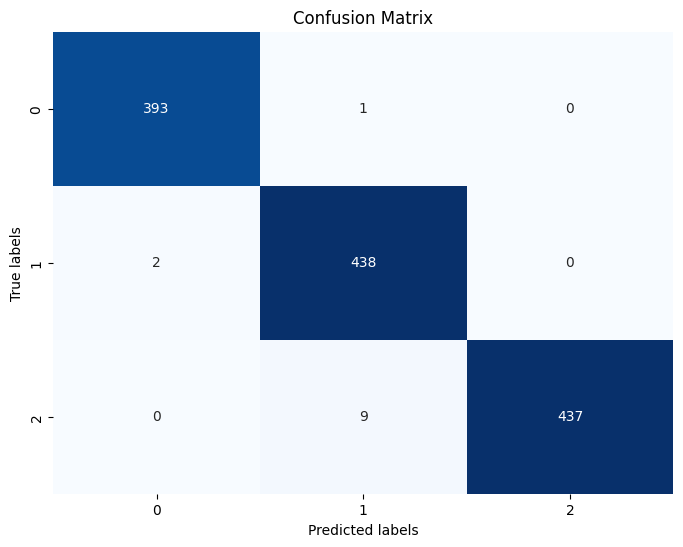

In [79]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, confusion_matrix
from imblearn.over_sampling import SMOTE
from xgboost import XGBClassifier
from sklearn.preprocessing import StandardScaler, LabelEncoder

# Load your dataset
file_path = (r"C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\all_features.csv")
df = pd.read_csv(file_path)

# Drop the last column
df = df.iloc[:, :-1]

# Assuming the first column is the target variable
X = df.iloc[:, 1:]  # Features
y = df.iloc[:, 0]   # Target

# Convert continuous values to discrete classes
thresholds = [0.98, 0.975]  # Adjust these thresholds as needed
labels = []

for value in y:
    if value >= thresholds[0]:
        labels.append('normal')  # Class for high values
    elif value >= thresholds[1]:
        labels.append('violence')  # Class for mid-range values
    else:
        labels.append('weaponized')  # Class for lower values

# Convert to categorical
y = pd.Series(labels)

# Convert categorical labels to numeric using LabelEncoder
label_encoder = LabelEncoder()
y = label_encoder.fit_transform(y)

# Normalize the dataset
scaler = StandardScaler()
X_normalized = scaler.fit_transform(X)

# Apply SMOTE to the normalized dataset
smote = SMOTE(random_state=42)
X_resampled, y_resampled = smote.fit_resample(X_normalized, y)

# Split the resampled data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_resampled, y_resampled, test_size=0.2, random_state=42)

# Create XGBoost classifier
xgb_classifier = XGBClassifier(random_state=42)

# Train the classifier
xgb_classifier.fit(X_train, y_train)

# Make predictions on the test set
y_pred = xgb_classifier.predict(X_test)

# Evaluate accuracy
accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)

# Display confusion matrix
conf_matrix = confusion_matrix(y_test, y_pred)
print("\nConfusion Matrix:\n", conf_matrix)

# Plot confusion matrix
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", cbar=False)
plt.title("Confusion Matrix")
plt.xlabel("Predicted labels")
plt.ylabel("True labels")
plt.show()


KNN

Accuracy: 0.965625

Confusion Matrix:
 [[390   4   0]
 [  0 438   2]
 [  2  36 408]]


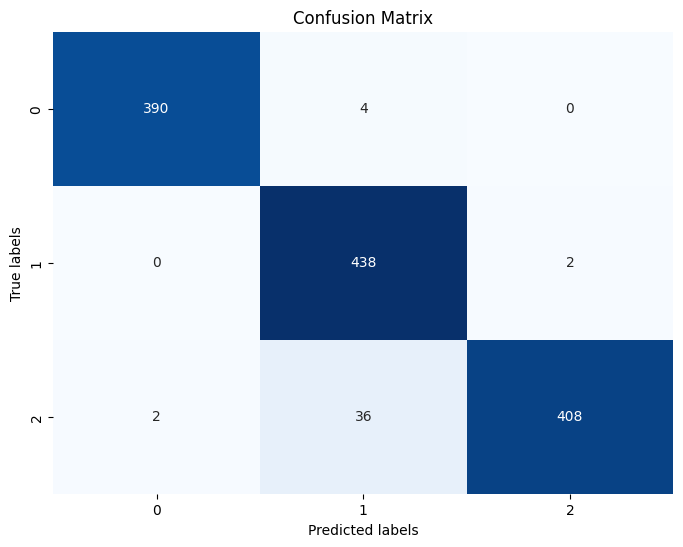

In [80]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, confusion_matrix
from imblearn.over_sampling import SMOTE
from sklearn.neighbors import KNeighborsClassifier
from sklearn.preprocessing import StandardScaler, LabelEncoder

# Load your dataset
file_path = r"C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\all_features.csv"
df = pd.read_csv(file_path)

# Drop the last column
df = df.iloc[:, :-1]

# Assuming the first column is the target variable
X = df.iloc[:, 1:]  # Features
y = df.iloc[:, 0]   # Target

# Convert continuous values to discrete classes (if needed)
thresholds = [0.98, 0.975]  # Adjust these thresholds as needed
labels = []

for value in y:
    if value >= thresholds[0]:
        labels.append('normal')  # Class for high values
    elif value >= thresholds[1]:
        labels.append('violence')  # Class for mid-range values
    else:
        labels.append('weaponized')  # Class for lower values

# Convert to categorical
y = pd.Series(labels)

# Convert categorical labels to numeric using LabelEncoder
label_encoder = LabelEncoder()
y = label_encoder.fit_transform(y)

# Normalize the dataset
scaler = StandardScaler()
X_normalized = scaler.fit_transform(X)

# Apply SMOTE to the normalized dataset
smote = SMOTE(random_state=42)
X_resampled, y_resampled = smote.fit_resample(X_normalized, y)

# Split the resampled data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_resampled, y_resampled, test_size=0.2, random_state=42)

# Create KNN classifier
knn_classifier = KNeighborsClassifier()

# Train the classifier
knn_classifier.fit(X_train, y_train)

# Make predictions on the test set
y_pred = knn_classifier.predict(X_test)

# Evaluate accuracy
accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)

# Display confusion matrix
conf_matrix = confusion_matrix(y_test, y_pred)
print("\nConfusion Matrix:\n", conf_matrix)

# Plot confusion matrix
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", cbar=False)
plt.title("Confusion Matrix")
plt.xlabel("Predicted labels")
plt.ylabel("True labels")
plt.show()


LGBM

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001501 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2805
[LightGBM] [Info] Number of data points in the train set: 2162, number of used features: 11
[LightGBM] [Info] Start training from score 0.929585
Mean Squared Error (MSE): 0.00015474817568967693
R-squared (R2): 0.9660602603964765

Actual vs Predicted values:
         Actual  Predicted
945   0.892683   0.892590
1576  0.995599   0.996694
1405  0.963812   0.964124
1260  0.936448   0.934785
2297  0.894544   0.892670
Training Time: 0.21663951873779297 seconds
Testing Time: 0.0037543773651123047 seconds


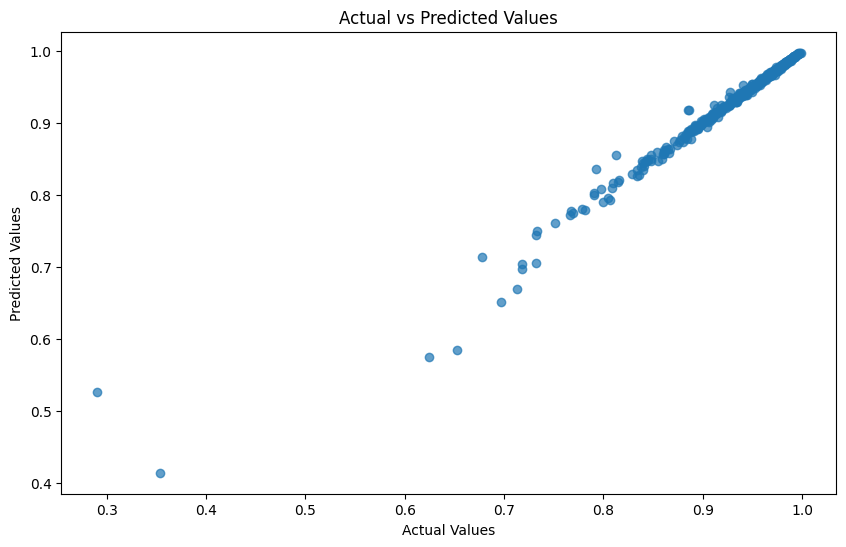

In [95]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
from lightgbm import LGBMRegressor
from sklearn.preprocessing import StandardScaler
import time

# Load your dataset
file_path = (r"C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\all_features.csv")
df = pd.read_csv(file_path)

# Drop the last column
df = df.iloc[:, :-1]

# Assuming the first column is the target variable (continuous)
X = df.iloc[:, 1:]  # Features
y = df.iloc[:, 0]   # Target (continuous)

# Normalize the dataset
scaler = StandardScaler()
X_normalized = scaler.fit_transform(X)

# Split the normalized data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_normalized, y, test_size=0.2, random_state=42)

# Create LightGBM Regressor
lgbm_regressor = LGBMRegressor(random_state=42)

# Train the regressor and track the training time
start_train_time = time.time()
lgbm_regressor.fit(X_train, y_train)
end_train_time = time.time()

# Make predictions on the test set and track the testing time
start_test_time = time.time()
y_pred = lgbm_regressor.predict(X_test)
end_test_time = time.time()

# Calculate evaluation metrics
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

# Display evaluation metrics
print("Mean Squared Error (MSE):", mse)
print("R-squared (R2):", r2)

# Display confusion matrix-like structure for regression (Actual vs Predicted)
actual_vs_predicted = pd.DataFrame({'Actual': y_test, 'Predicted': y_pred})
print("\nActual vs Predicted values:\n", actual_vs_predicted.head())

# Display training and testing time
print("Training Time:", end_train_time - start_train_time, "seconds")
print("Testing Time:", end_test_time - start_test_time, "seconds")

# Plot Actual vs Predicted values
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred, alpha=0.7)
plt.xlabel("Actual Values")
plt.ylabel("Predicted Values")
plt.title("Actual vs Predicted Values")
plt.show()


ENSEMBLING MODEL

Mean Squared Error (MSE): 0.00047599955889395
R-Squared (R2 Score): 0.8956026395254595


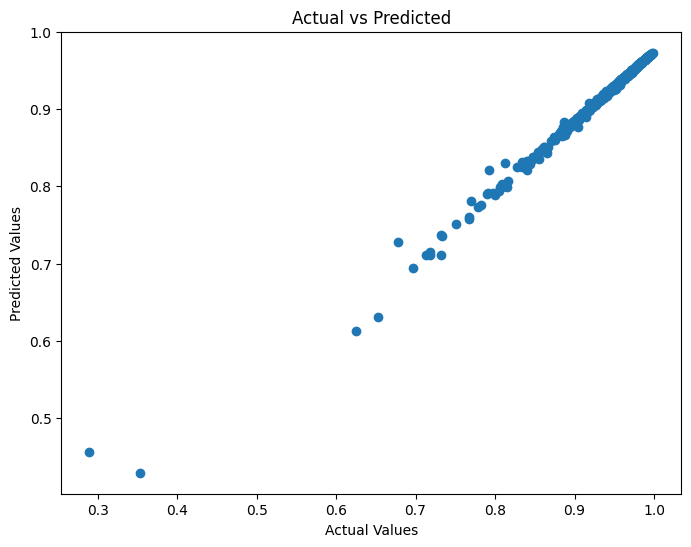

Training Time: 3.2114524841308594 seconds
Testing Time: 0.0254819393157959 seconds


In [96]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.ensemble import VotingRegressor, RandomForestRegressor, GradientBoostingRegressor
from sklearn.linear_model import Ridge
from sklearn.svm import SVR
from sklearn.preprocessing import StandardScaler
import time

# Load your dataset
file_path = (r"C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\all_features.csv")
df = pd.read_csv(file_path)

# Drop the last column
df = df.iloc[:, :-1]

# Assuming the first column is the target variable (continuous)
X = df.iloc[:, 1:]  # Features
y = df.iloc[:, 0]   # Target

# Normalize the dataset
scaler = StandardScaler()
X_normalized = scaler.fit_transform(X)

# Split the normalized data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_normalized, y, test_size=0.2, random_state=42)

# Create individual models
rf_regressor = RandomForestRegressor(random_state=42)
gb_regressor = GradientBoostingRegressor(random_state=42)
ridge_regressor = Ridge(random_state=42)
svr_regressor = SVR(kernel='linear')

# Create a Voting Regressor (Ensemble of models)
ensemble_regressor = VotingRegressor([('rf', rf_regressor), ('gb', gb_regressor), ('ridge', ridge_regressor), ('svr', svr_regressor)])

# Train the ensemble model and track the training time
start_train_time = time.time()
ensemble_regressor.fit(X_train, y_train)
end_train_time = time.time()

# Make predictions on the test set
start_test_time = time.time()
y_pred = ensemble_regressor.predict(X_test)
end_test_time = time.time()

# Calculate evaluation metrics
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

# Display evaluation metrics
print("Mean Squared Error (MSE):", mse)
print("R-Squared (R2 Score):", r2)

# Plot predicted vs actual values
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_pred)
plt.xlabel("Actual Values")
plt.ylabel("Predicted Values")
plt.title("Actual vs Predicted")
plt.show()

# Display training and testing time
print("Training Time:", end_train_time - start_train_time, "seconds")
print("Testing Time:", end_test_time - start_test_time, "seconds")


FEEDFORWARD NEURAL NETWORK

Epoch 1/50
55/55 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - loss: 0.5412 - val_loss: 0.1613
Epoch 2/50
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 0.0995 - val_loss: 0.0439
Epoch 3/50
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 0.0390 - val_loss: 0.0211
Epoch 4/50
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0145 - val_loss: 0.0235
Epoch 5/50
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 0.0058 - val_loss: 0.0053
Epoch 6/50
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 0.0037 - val_loss: 0.0062
Epoch 7/50
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 0.0021 - val_loss: 0.0043
Epoch 8/50
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 0.0022 - val_loss: 0.0038
Epoch 9/50
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 0.0019 - val_loss: 0.0038
Epoch 10/50
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 0.0017 - val_loss: 0.0078
Epoch 11/50
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0022 - val_loss: 0.0035
Epoch 12/50
55/55 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 0.0022 - val_lo

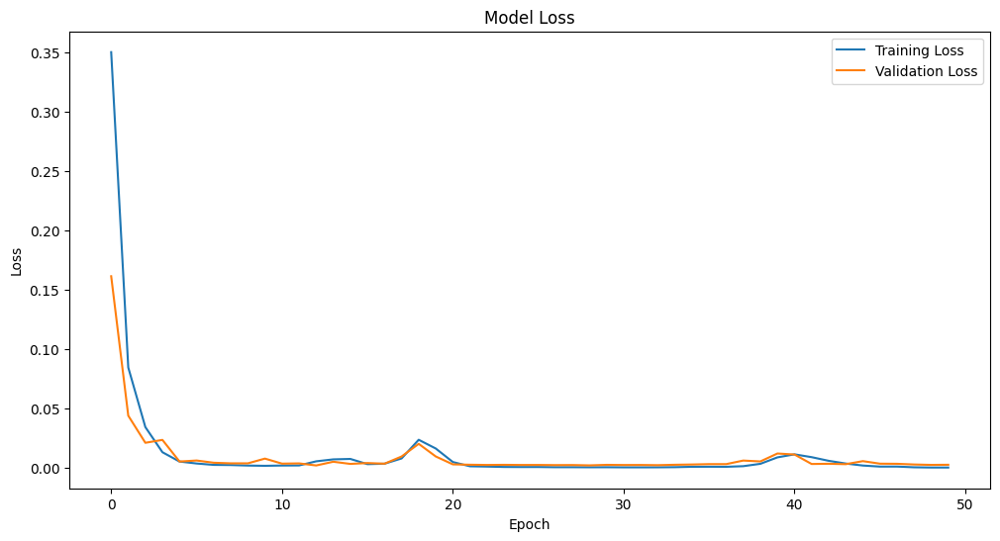

In [97]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import StandardScaler
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
import time
from sklearn.metrics import r2_score
# Load your dataset
file_path = r"C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\kaggle\all_features.csv"
df = pd.read_csv(file_path)

# Drop the last column
df = df.iloc[:, :-1]

# Assuming the first column is the target variable
X = df.iloc[:, 1:]  # Features
y = df.iloc[:, 0]   # Target

# Normalize the dataset
scaler = StandardScaler()
X_normalized = scaler.fit_transform(X)

# Split the normalized data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_normalized, y, test_size=0.2, random_state=42)

# Define the deep learning model
model = keras.Sequential([
    layers.Input(shape=(X_train.shape[1],)),
    layers.Dense(64, activation='relu'),
    layers.Dense(32, activation='relu'),
    layers.Dense(1)  # Adjust the number of units for your output (1 for regression)
])

# Compile the model
model.compile(optimizer='adam', loss='mean_squared_error')

# Train the model and track the training time
start_train_time = time.time()
history = model.fit(X_train, y_train, epochs=50, validation_split=0.2, verbose=1)
end_train_time = time.time()

# Make predictions on the test set
y_pred = model.predict(X_test)

# Calculate Mean Squared Error for evaluation
mse = mean_squared_error(y_test, y_pred)

# Display evaluation metrics
print("Mean Squared Error (MSE):", mse)


# Calculate R-squared
r2 = r2_score(y_test, y_pred)

# Display R-squared
print("R-Squared (R2 Score):", r2)

# Display training time
print("Training Time:", end_train_time - start_train_time, "seconds")

# Optionally plot the training history
plt.figure(figsize=(12, 6))
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend()
plt.show()


In [16]:
# Input video path
video_path = r'C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\SCVD\SCVD_converted_sec_split\Test\Violence\Violence-Test001.avi'
frames_dir = r'C:\Users\LEELA\Desktop\CYS\5TH SEM\AINN Project\prediction'  # Replace with your actual path

# Function to print frame shape for debugging
def print_frame_info(frame, frame_number):
    if frame is not None:
        print(f"Frame {frame_number} shape: {frame.shape}")
    else:
        print(f"Frame {frame_number} is None (missing or unreadable)")

# Convert video to frames (assuming this function works properly)
num_frames = video_to_frames(video_path, frames_dir)
print(f"Total number of frames: {num_frames}")

# Calculate optical flow and extract features
optical_flow_frames = []
for i in range(1, num_frames):
    frame1_path = os.path.join(frames_dir, f'frame_{i-1:04d}.png')
    frame2_path = os.path.join(frames_dir, f'frame_{i:04d}.png')
    
    frame1 = cv2.imread(frame1_path)
    frame2 = cv2.imread(frame2_path)
    
    print_frame_info(frame1, i-1)
    print_frame_info(frame2, i)
    
    if frame1 is None or frame2 is None:
        print(f"Skipping frames {i-1} and {i} due to missing or unreadable files.")
        continue
    
    # Calculate optical flow
    optical_flow = calculate_optical_flow(frame1, frame2)
    optical_flow_frames.append(optical_flow)

    print(f"Optical flow for frames {i-1} and {i}: {optical_flow.shape}")

# Extract features from optical flow frames
feature_vectors = extract_features_from_optical_flow(optical_flow_frames)
print(f"Extracted feature vectors: {feature_vectors}")
print(f"Shape of feature vectors: {feature_vectors.shape}")

# Check if the feature vector size is at least 12
if len(feature_vectors) >= 12:
    feature_vectors = feature_vectors[:12]  # Select only the first 12 features
else:
    raise ValueError(f"Insufficient feature vector size ({len(feature_vectors)}) for the model input. Expected at least 12.")

print(f"Reshaped feature vectors (for model input): {feature_vectors}")

# Reshape to (1, 12) for both models
feature_vectors_model1 = feature_vectors.reshape((1, 12))
feature_vectors_model2 = feature_vectors.reshape((1, 12))

# Make predictions using both models
predictions_model1 = model1.predict(feature_vectors_model1)
predictions_model2 = model2.predict(feature_vectors_model2)

print(f"Model 1 predictions: {predictions_model1}")
print(f"Model 2 predictions: {predictions_model2}")

# Combine predictions (average of both models)
combined_predictions = (predictions_model1 + predictions_model2) / 2
print(f"Combined predictions: {combined_predictions}")

# Output the final prediction
final_class = np.argmax(combined_predictions, axis=1)
print(f"Predicted class: {final_class}")

Total number of frames: 30
Frame 0 shape: (720, 1280, 3)
Frame 1 shape: (720, 1280, 3)
Optical flow for frames 0 and 1: (720, 1280)
Frame 1 shape: (720, 1280, 3)
Frame 2 shape: (720, 1280, 3)
Optical flow for frames 1 and 2: (720, 1280)
Frame 2 shape: (720, 1280, 3)
Frame 3 shape: (720, 1280, 3)
Optical flow for frames 2 and 3: (720, 1280)
Frame 3 shape: (720, 1280, 3)
Frame 4 shape: (720, 1280, 3)
Optical flow for frames 3 and 4: (720, 1280)
Frame 4 shape: (720, 1280, 3)
Frame 5 shape: (720, 1280, 3)
Optical flow for frames 4 and 5: (720, 1280)
Frame 5 shape: (720, 1280, 3)
Frame 6 shape: (720, 1280, 3)
Optical flow for frames 5 and 6: (720, 1280)
Frame 6 shape: (720, 1280, 3)
Frame 7 shape: (720, 1280, 3)
Optical flow for frames 6 and 7: (720, 1280)
Frame 7 shape: (720, 1280, 3)
Frame 8 shape: (720, 1280, 3)
Optical flow for frames 7 and 8: (720, 1280)
Frame 8 shape: (720, 1280, 3)
Frame 9 shape: (720, 1280, 3)
Optical flow for frames 8 and 9: (720, 1280)
Frame 9 shape: (720, 1280, 3

In [11]:
print(model1.input_shape)
print(model2.input_shape)


(None, 12)
(None, 12)


In [6]:
# Load your Keras models
model1 = load_model('enhanced_optical_flow_nn_model.h5')
model2 = load_model('optical_flow_nn_model.h5')

# Print model summaries to inspect the expected input shape
print(model1.summary())
print(model2.summary())


Model: "sequential_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense_10 (Dense)                │ (None, 256)            │         3,328 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_4           │ (None, 256)            │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_5 (Dropout)             │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_11 (Dense)                │ (None, 128)            │        32,896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_5           │ (None, 128)            │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_6 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_12 (Dense)                │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_6           │ (None, 64)             │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_7 (Dropout)             │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_13 (Dense)                │ (None, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_7           │ (None, 32)             │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_8 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_14 (Dense)                │ (None, 3)              │            99 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 48,581 (189.77 KB)

 Trainable params: 47,619 (186.01 KB)

 Non-trainable params: 960 (3.75 KB)

 Optimizer params: 2 (12.00 B)

None


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense (Dense)                   │ (None, 128)            │         1,664 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 3)              │            99 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 12,101 (47.27 KB)

 Trainable params: 12,099 (47.26 KB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 2 (12.00 B)

None
